In [4]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.metrics.cluster import silhouette_score
from collections import Counter
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import FunctionTransformer
import warnings
warnings.filterwarnings("ignore")

In [5]:
results = {}

In [6]:
X_train = pd.read_csv('data/umist_cropped.csv')

In [7]:
X_train = X_train.to_numpy()

In [8]:
def scaler(X):
    return X / 255.0

In [9]:
X_train = scaler(X_train)

### PCA

In [10]:
pca = PCA(n_components=0.995, random_state=123)
X_train_pca = pca.fit_transform(X_train)

In [11]:
X_train_pca.shape

(600, 416)

In [12]:
n_cluster_range = range(10, 25)

silhouette_scores = []
dbcv_scores = []

for n_clusters in n_cluster_range:
    kmeans = KMeans(n_clusters=n_clusters, random_state=123, n_init=50, init='k-means++')
    labels = kmeans.fit_predict(X_train_pca)
    
    silhouette_scores.append(silhouette_score(X_train_pca, labels))

best_n_clusters_pca = n_cluster_range[np.argmax(silhouette_scores)]
best_n_clusters_index = np.argmax(silhouette_scores)

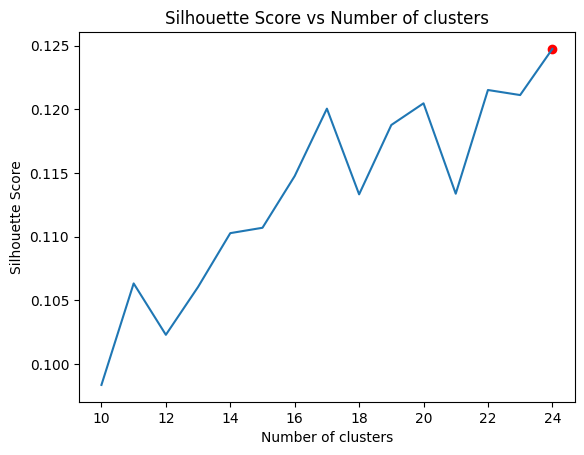

Best number of clusters: 24


In [13]:
plt.plot(n_cluster_range, silhouette_scores)
plt.scatter(n_cluster_range[best_n_clusters_index], silhouette_scores[best_n_clusters_index], color='red')
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score vs Number of clusters')
plt.show()

print(f'Best number of clusters: {best_n_clusters_pca}')

In [14]:
kmeans_pca = KMeans(n_clusters=best_n_clusters_pca, random_state=123, max_iter=1000, n_init=50, init='k-means++')
kmeans_pca.fit(X_train_pca)
kmeans_labels_pca = kmeans_pca.predict(X_train_pca)

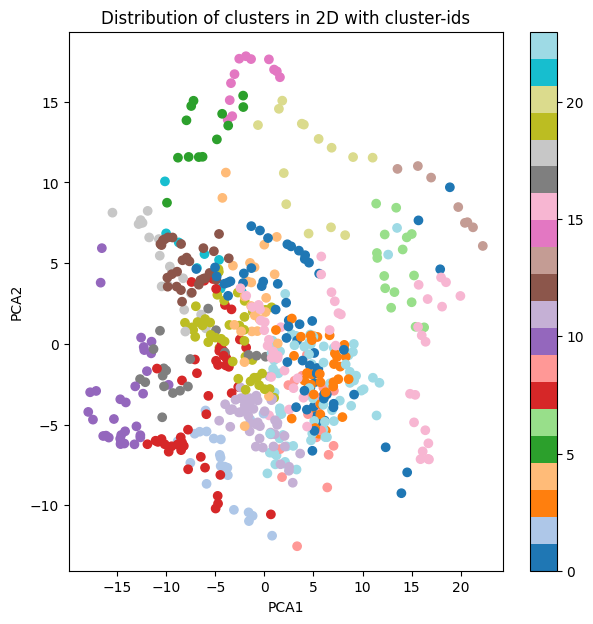

In [15]:
# Plot the distribution of clusters in 2D with their cluster-ids
plt.figure(figsize=(7, 7))
plt.scatter(X_train_pca[:, 0], X_train_pca[:, 1], c=kmeans_labels_pca, cmap='tab20')
plt.xlabel('PCA1')
plt.ylabel('PCA2') 
plt.title('Distribution of clusters in 2D with cluster-ids')
plt.colorbar()
plt.show()

In [16]:
print(f'Silhouette score: {silhouette_score(X_train_pca, kmeans_labels_pca)}')

Silhouette score: 0.12473936552709665


In [17]:
# Save to results
results['PCA'] = {
    'silhouette_score': silhouette_score(X_train_pca, kmeans_labels_pca),
    'n_clusters': best_n_clusters_pca
}

Counter({22: 53, 11: 45, 19: 44, 3: 37, 0: 32, 10: 31, 15: 31, 1: 31, 12: 28, 4: 26, 8: 26, 9: 25, 2: 23, 7: 22, 17: 20, 18: 19, 16: 18, 23: 18, 6: 16, 20: 14, 5: 13, 14: 12, 13: 8, 21: 8})


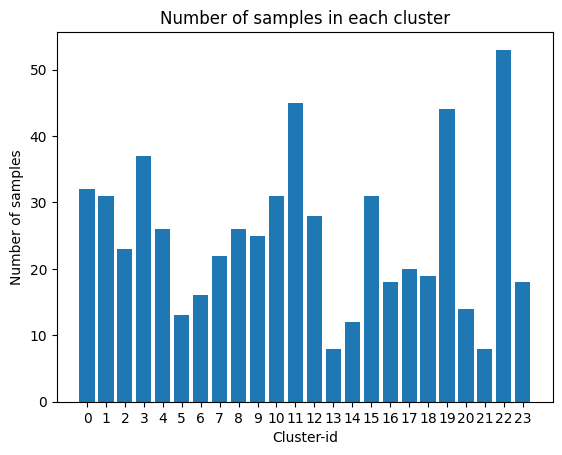

In [18]:
print(Counter(kmeans_labels_pca))

plt.bar(Counter(kmeans_labels_pca).keys(), Counter(kmeans_labels_pca).values())
plt.xlabel('Cluster-id')
plt.ylabel('Number of samples')
plt.title('Number of samples in each cluster')
plt.xticks(range(best_n_clusters_pca))
plt.show()

In [19]:
# Plot images of each cluster
umist_data = pd.read_csv("data/umist_cropped.csv")

umist_data['cluster_id'] = kmeans_labels_pca

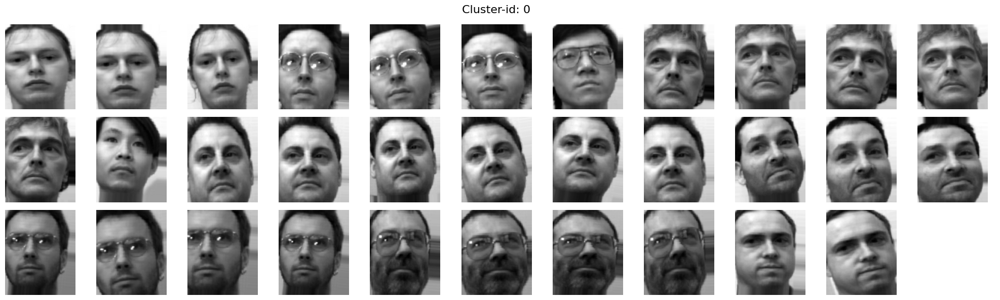

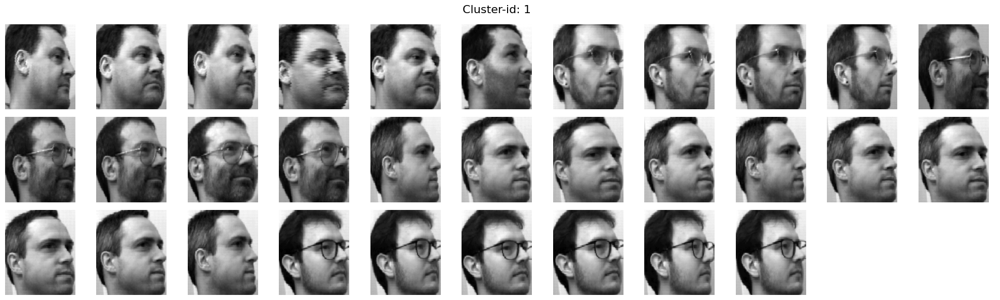

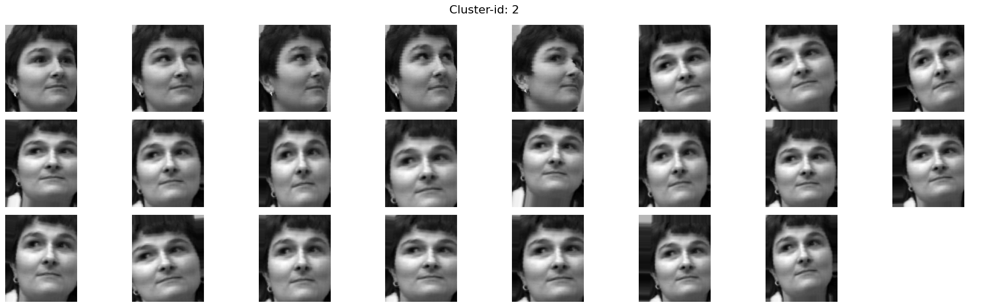

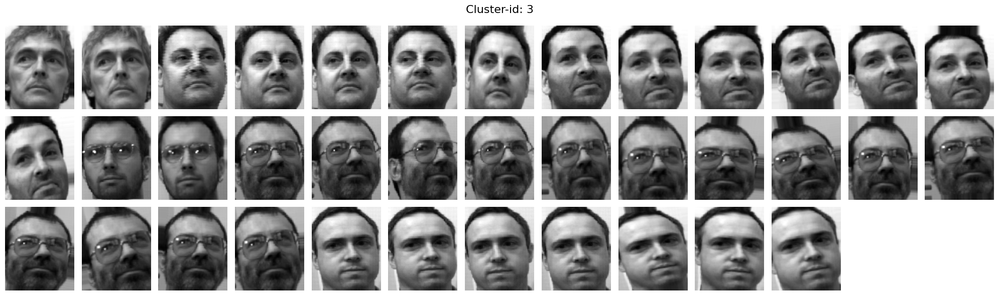

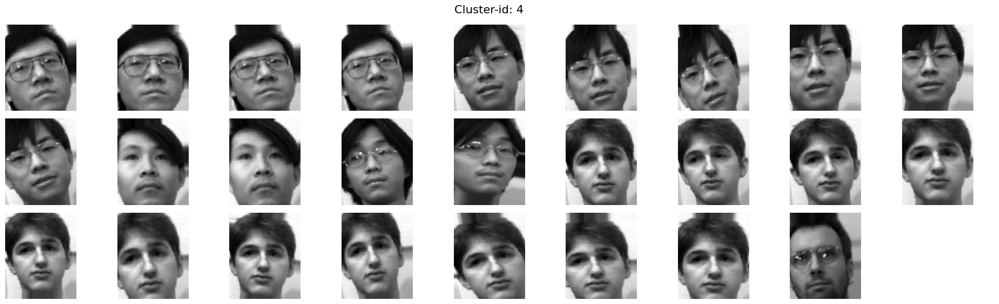

...

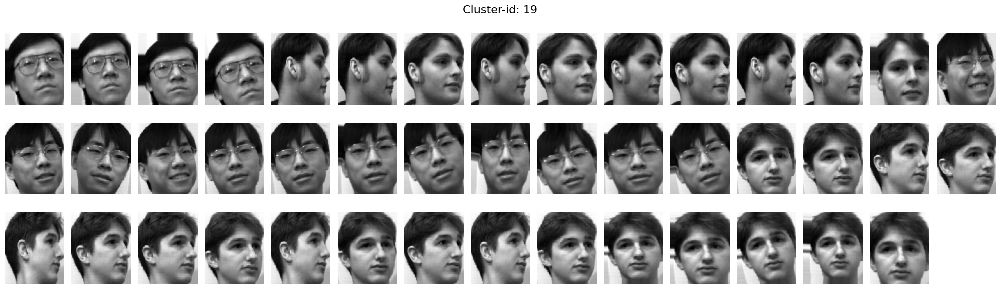

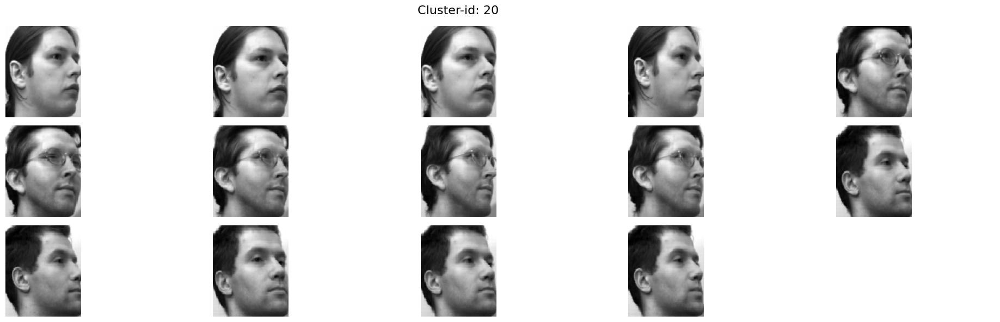

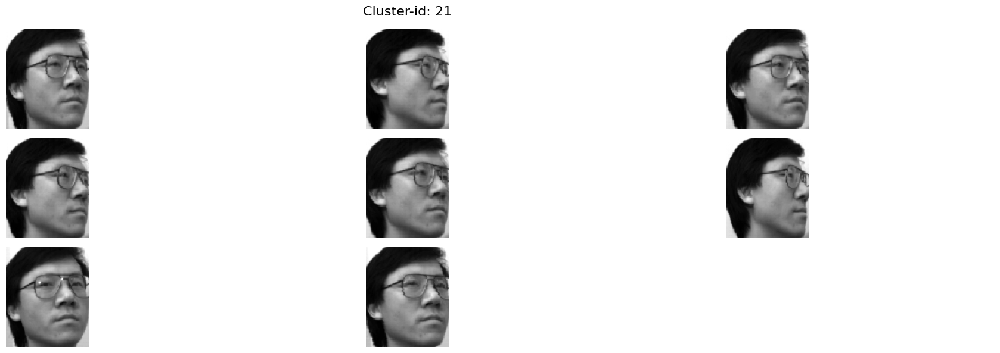

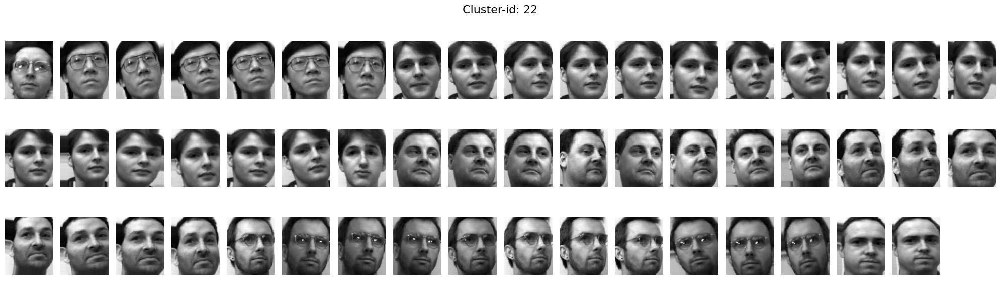

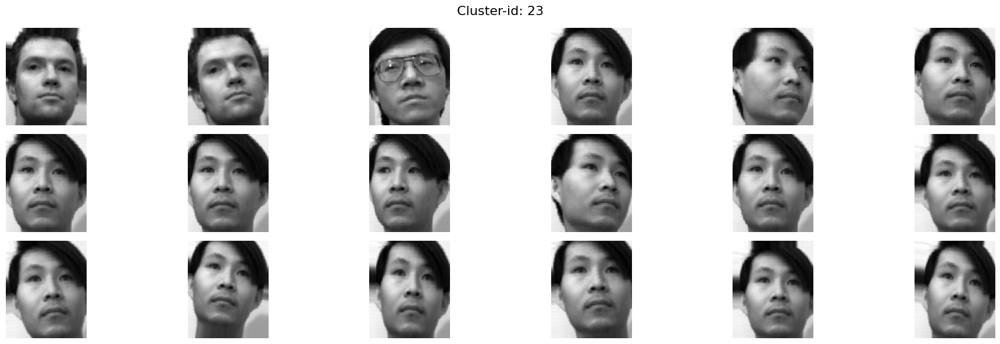

In [20]:
plt_range = None
if 0 not in Counter(labels).keys():
    plt_range = (1, best_n_clusters_pca + 1)
else:
    plt_range = (0, best_n_clusters_pca)

for cluster_id in range(plt_range[0], plt_range[1]):
    cluster_indices = umist_data[umist_data['cluster_id'] == cluster_id].index
    num_images = min(max(Counter(kmeans_labels_pca).values()), len(cluster_indices))
    
    if num_images > 0:
        # Define grid dimensions
        num_rows = 3
        num_cols = (num_images + num_rows - 1) // num_rows  # Ceiling division for columns
        
        fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 6))
        axes = axes.flatten()  # Flatten to handle indexing easily
        
        for i in range(num_rows * num_cols):
            if i < num_images:
                img_idx = cluster_indices[i]
                img = umist_data.iloc[img_idx, :-1].to_numpy().reshape(112, 92)
                
                axes[i].imshow(img, cmap='gray')
                axes[i].axis('off')
            else:
                # Hide unused subplots
                axes[i].axis('off')
        
        plt.suptitle(f'Cluster-id: {cluster_id}', fontsize=16)
        plt.tight_layout()
        plt.show()

In [21]:
# Plot the distribution of each cluster
original_data = pd.read_csv("data/umist_with_original_face_id.csv")

In [22]:
original_data['cluster_id'] = kmeans_labels_pca

In [23]:
original_labels = original_data['label']
clustered_labels = original_data['cluster_id']

In [24]:
unique_labels = np.unique(original_labels)
unique_clustered_labels = np.unique(clustered_labels)

original_labels = original_labels.to_numpy()
clustered_labels = clustered_labels.to_numpy()

In [25]:
def autopct_format(pct):
    return f'{pct:.1f}%' if pct >= 10 else ''

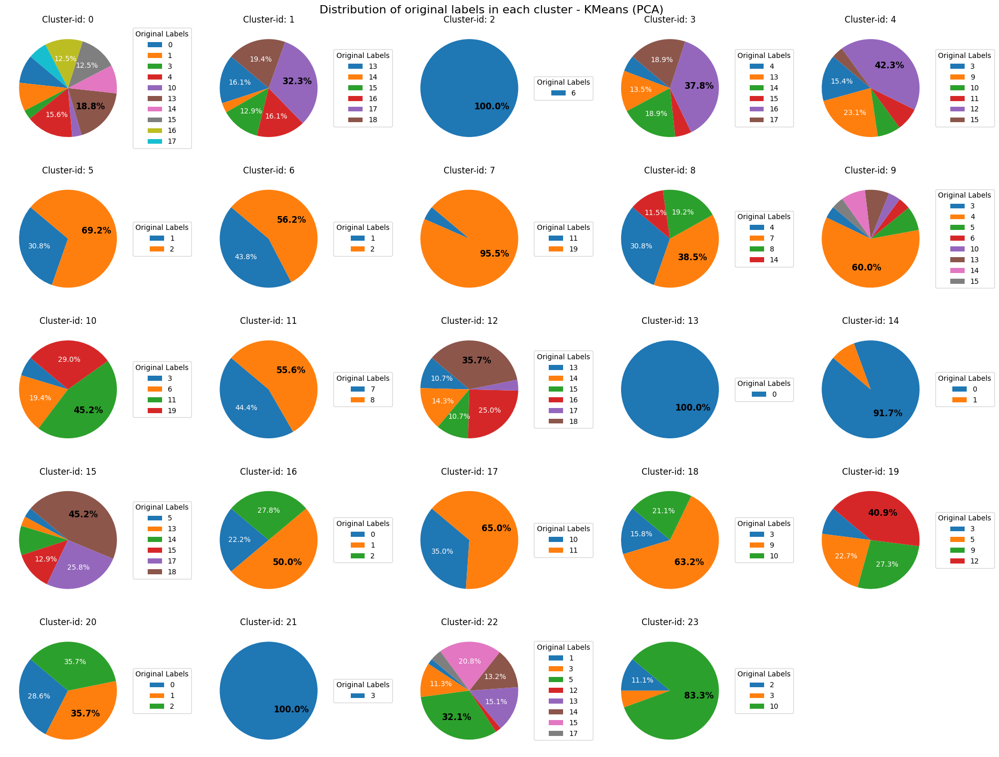

In [26]:
df = pd.DataFrame({'Original Labels': original_labels, 'Clustered Labels': clustered_labels})

num_clusters = len(unique_clustered_labels)
fig, axes = plt.subplots(5, 5, figsize=(20, 15), subplot_kw=dict(aspect="equal"))

axes = axes.flatten()

for i, cluster in enumerate(unique_clustered_labels):
    cluster_data = df[df['Clustered Labels'] == cluster]
    cluster_original_labels = cluster_data['Original Labels']
    
    cluster_original_labels_count = Counter(cluster_original_labels)
    labels = list(cluster_original_labels_count.keys())
    counts = list(cluster_original_labels_count.values())
    
    wedges, texts, autotexts = axes[i].pie(counts, labels=labels, autopct=lambda pct: autopct_format(pct), textprops=dict(color="w"), startangle=140)
    
    axes[i].legend(wedges, labels, title='Original Labels', loc='center left', bbox_to_anchor=(1, 0, 0.5, 1))
    
    largest_pct_idx = np.argmax(counts)
    autotexts[largest_pct_idx].set_color('black')
    autotexts[largest_pct_idx].set_fontsize(12)
    autotexts[largest_pct_idx].set_fontweight('bold')
        
    axes[i].set_title(f'Cluster-id: {cluster}')
        
    
for j in range(i + 1, len(axes)):
    axes[j].axis('off')
        
plt.suptitle('Distribution of original labels in each cluster - KMeans (PCA)', fontsize=16)
plt.tight_layout()
plt.show()

### Fine best n_components for UMAP and best n_clusters for KMeans

In [27]:
umap_range = range(2, 15)
n_cluster_range_umap = range(10, 25)

silhouette_scores_umap = []

for n_components in umap_range:
    for n_clusters in n_cluster_range_umap:
        import umap.umap_ as umap
        umap_model = umap.UMAP(n_components=n_components, random_state=123)
        X_train_umap = umap_model.fit_transform(X_train_pca)
        
        kmeans = KMeans(n_clusters=n_clusters, random_state=123, n_init=50, init='k-means++')
        labels = kmeans.fit_predict(X_train_umap)
        
        silhouette_score_umap = silhouette_score(X_train_umap, labels)
        silhouette_scores_umap.append(silhouette_score_umap)
        
best_n_components, best_n_clusters = np.unravel_index(np.argmax(silhouette_scores_umap), (len(umap_range), len(n_cluster_range_umap)))

print(f'Best number of components for UMAP: {umap_range[best_n_components]}')
print(f'Best number of clusters: {n_cluster_range_umap[best_n_clusters]}')  

Best number of components for UMAP: 2
Best number of clusters: 24


In [28]:
import umap.umap_ as umap
best_umap = umap.UMAP(n_components=umap_range[best_n_components], random_state=123)
X_train_umap = best_umap.fit_transform(X_train_pca)

kmeans_umap = KMeans(n_clusters=n_cluster_range_umap[best_n_clusters], random_state=123, n_init=50, init='k-means++')
kmeans_umap.fit(X_train_umap)
kmeans_labels_umap = kmeans_umap.predict(X_train_umap)

In [29]:
print(f'Silhouette score: {silhouette_score(X_train_umap, kmeans_labels_umap)}')

Silhouette score: 0.5274640917778015


In [30]:
# Save to results
results['UMAP'] = {
    'silhouette_score': silhouette_score(X_train_umap, kmeans_labels_umap),
    'n_clusters': n_cluster_range_umap[best_n_clusters]
}

Distribution of clustered labels
Counter({7: 43, 12: 38, 11: 36, 5: 31, 3: 28, 8: 28, 13: 28, 18: 27, 10: 27, 4: 27, 14: 26, 23: 25, 20: 25, 9: 24, 2: 24, 16: 22, 15: 21, 1: 20, 19: 20, 0: 19, 21: 19, 6: 17, 17: 17, 22: 8})


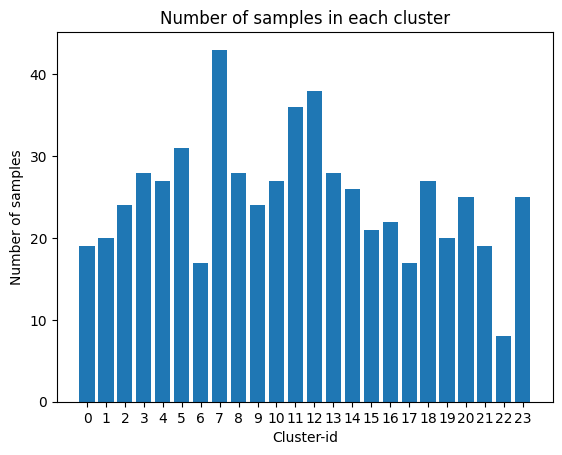

In [31]:
print("Distribution of clustered labels")
print(Counter(kmeans_labels_umap))

plt.bar(Counter(kmeans_labels_umap).keys(), Counter(kmeans_labels_umap).values())
plt.xlabel('Cluster-id')
plt.ylabel('Number of samples')
plt.title('Number of samples in each cluster')
plt.xticks(range(n_cluster_range_umap[best_n_clusters]))
plt.show()

In [32]:
# Plot images of each cluster
umist_data = pd.read_csv("data/umist_cropped.csv")

umist_data['cluster_id'] = kmeans_labels_umap

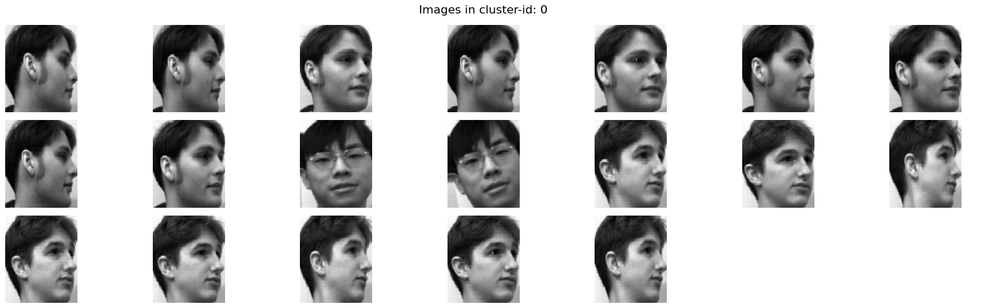

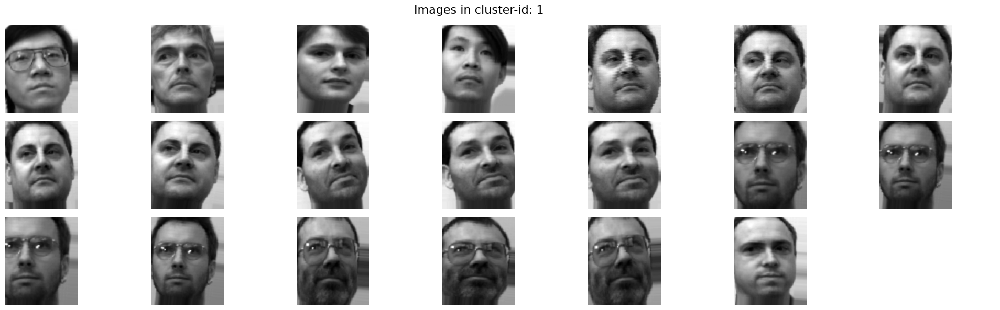

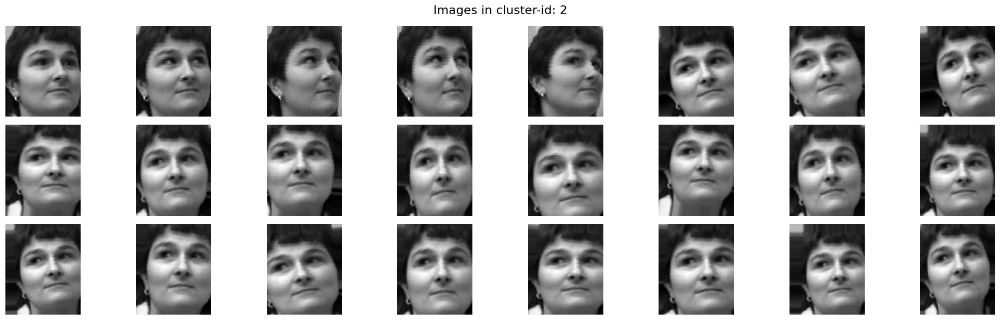

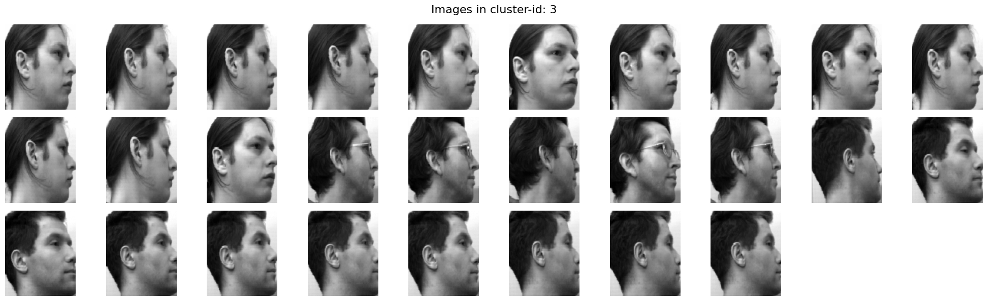

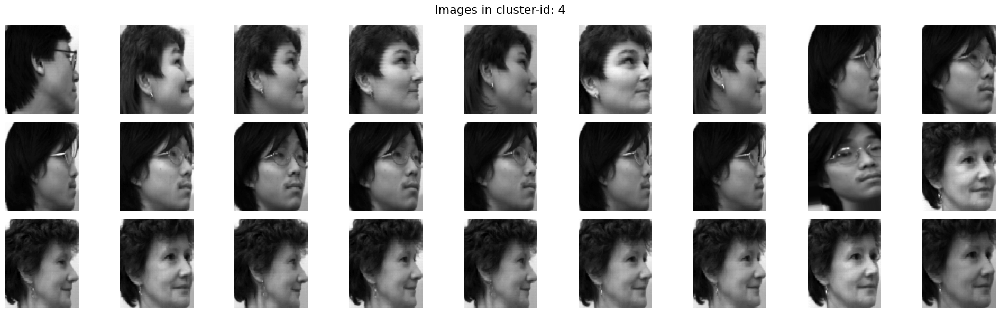

...

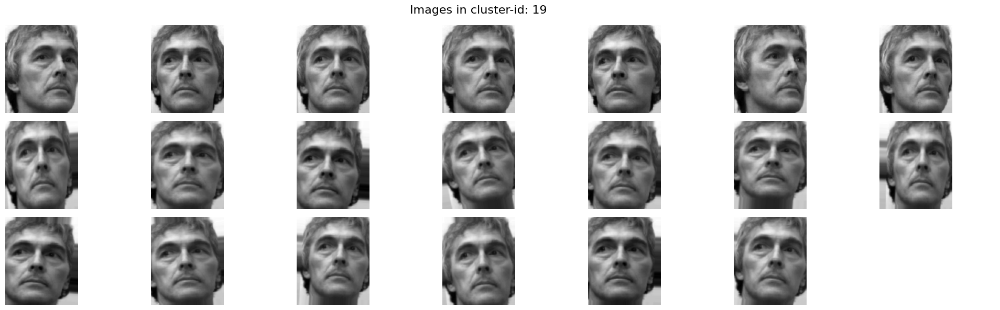

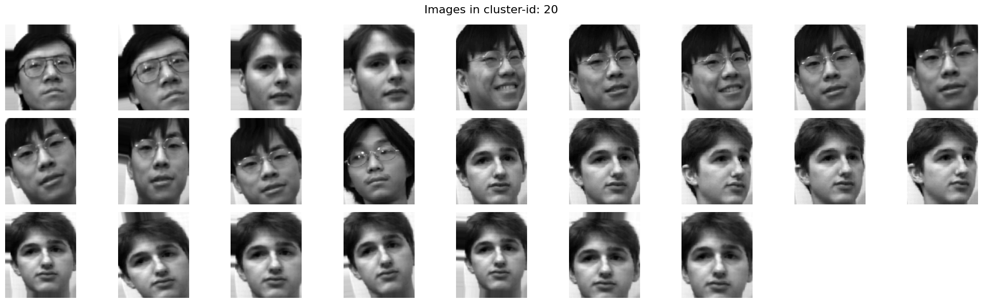

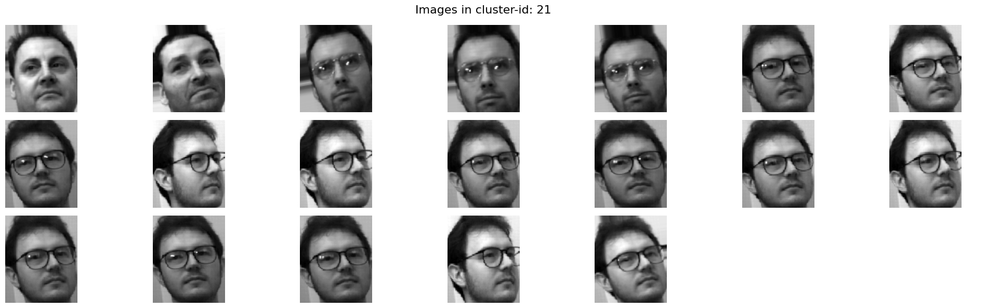

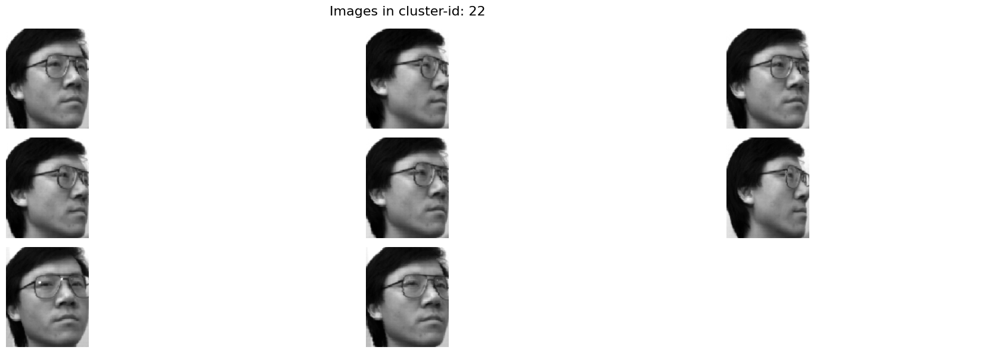

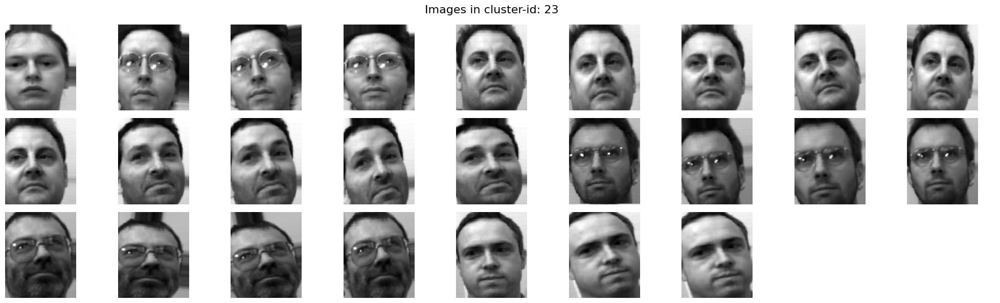

In [33]:
for cluster_id in range(n_cluster_range_umap[best_n_clusters]):
    cluster_indices = umist_data[umist_data['cluster_id'] == cluster_id].index
    
    num_images = min(max(Counter(kmeans_labels_umap).values()), len(cluster_indices))
    
    if num_images > 0:
        # Define the grid dimensions for 3 rows
        num_rows = 3
        num_cols = (num_images + num_rows - 1) // num_rows  # Ceiling division to calculate columns
        
        fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 6))
        axes = axes.flatten()  # Flatten axes array for easy indexing
        
        for i in range(num_rows * num_cols):
            if i < num_images:
                image_idx = cluster_indices[i]
                image_data = umist_data.iloc[image_idx].values
                image = image_data[:-1].reshape(112, 92)
                
                axes[i].imshow(image, cmap='gray')
                axes[i].axis('off')
            else:
                # Hide unused subplots
                axes[i].axis('off')
        
        # Add a title for the cluster and adjust layout
        plt.suptitle(f'Images in cluster-id: {cluster_id}', fontsize=16)
        plt.tight_layout()
        plt.show()

In [34]:
# Plot the distribution of each cluster
original_data = pd.read_csv("data/umist_with_original_face_id.csv")

In [35]:
original_data['cluster_id'] = kmeans_labels_umap

In [36]:
original_labels = original_data['label']
clustered_labels = original_data['cluster_id']

In [37]:
unique_labels = np.unique(original_labels)
unique_clustered_labels = np.unique(clustered_labels)

original_labels = original_labels.to_numpy()
clustered_labels = clustered_labels.to_numpy()

In [38]:
def autopct_format(pct):
    return f'{pct:.1f}%' if pct >= 10 else ''

In [39]:
import math
def plot_cluster_distribution_with_majority(original_labels, clustered_labels):
    # Get unique clusters
    unique_clustered_labels = np.unique(clustered_labels)
    
    # Store the results for further sorting
    majority_labels = []
    majority_label_counts = Counter()

    # Calculate grid dimensions
    num_clusters = len(unique_clustered_labels)
    grid_size = math.ceil(math.sqrt(num_clusters))  # Determine size of the grid (square root for square layout)

    fig, axes = plt.subplots(grid_size, grid_size, figsize=(20, 15), subplot_kw=dict(aspect="equal"))
    axes = axes.flatten()

    for i, cluster in enumerate(unique_clustered_labels):
        # Filter data for the current cluster
        cluster_data_indices = np.where(clustered_labels == cluster)[0]
        cluster_original_labels = [original_labels[idx] for idx in cluster_data_indices]

        # Count occurrences of original labels in the current cluster
        cluster_original_labels_count = Counter(cluster_original_labels)
        labels = list(cluster_original_labels_count.keys())
        counts = list(cluster_original_labels_count.values())

        # Plot pie chart
        wedges, texts, autotexts = axes[i].pie(
            counts,
            labels=labels,
            autopct=lambda pct: f"{pct:.1f}%" if pct > 0 else '',
            textprops=dict(color="w"),
            startangle=140
        )

        axes[i].legend(wedges, labels, title='Original Labels', loc='center left', bbox_to_anchor=(1, 0, 0.5, 1))

        # Highlight the largest percentage
        largest_pct_idx = np.argmax(counts)
        autotexts[largest_pct_idx].set_color('black')
        autotexts[largest_pct_idx].set_fontsize(12)
        autotexts[largest_pct_idx].set_fontweight('bold')

        axes[i].set_title(f'Cluster-id: {cluster}')

        # Find majority label for the cluster
        majority_label, count = cluster_original_labels_count.most_common(1)[0]
        total = sum(cluster_original_labels_count.values())
        percentage = (count / total) * 100

        # Append the cluster, majority label, count, and percentage to the list
        majority_labels.append((cluster, majority_label, count, percentage))
        
        majority_label_counts[majority_label] += 1

    # Turn off unused subplots
    for j in range(num_clusters, len(axes)):
        axes[j].axis('off')

    # Separate clusters based on the percentage
    high_majority = [x for x in majority_labels if x[3] > 50]
    low_majority = [x for x in majority_labels if x[3] <= 50]

    # Sort high_majority by cluster ID
    high_majority.sort(key=lambda x: x[0])

    # Sort low_majority by majority label (true label)
    low_majority.sort(key=lambda x: x[1])

    # Print sorted results
    print("\nClusters with majority percentage > 50% (sorted by cluster ID):")
    for cluster, majority_label, count, percentage in high_majority:
        print(f"Cluster {cluster}: Majority label {majority_label} with {count} images ({percentage:.1f}%)")

    print("\nClusters with majority percentage <= 50% (sorted by true label):")
    for cluster, majority_label, count, percentage in low_majority:
        print(f"Cluster {cluster}: Majority label {majority_label} with {count} images ({percentage:.1f}%)")
        
    print("\nFrequency of each original label being the majority across clusters:")
    for label, count in majority_label_counts.items():
        if count > 1:
            print(f"Original label {label}: {count} time(s)")

    plt.suptitle('Distribution of original labels in each cluster', fontsize=16)
    plt.tight_layout()
    plt.show()


Clusters with majority percentage > 50% (sorted by cluster ID):
Cluster 2: Majority label 6 with 24 images (100.0%)
Cluster 7: Majority label 8 with 23 images (53.5%)
Cluster 9: Majority label 10 with 14 images (58.3%)
Cluster 15: Majority label 19 with 20 images (95.2%)
Cluster 17: Majority label 11 with 17 images (100.0%)
Cluster 19: Majority label 4 with 20 images (100.0%)
Cluster 21: Majority label 18 with 14 images (73.7%)
Cluster 22: Majority label 3 with 8 images (100.0%)

Clusters with majority percentage <= 50% (sorted by true label):
Cluster 3: Majority label 0 with 13 images (46.4%)
Cluster 6: Majority label 0 with 8 images (47.1%)
Cluster 18: Majority label 1 with 13 images (48.1%)
Cluster 5: Majority label 3 with 10 images (32.3%)
Cluster 0: Majority label 5 with 9 images (47.4%)
Cluster 14: Majority label 7 with 10 images (38.5%)
Cluster 8: Majority label 9 with 12 images (42.9%)
Cluster 4: Majority label 11 with 10 images (37.0%)
Cluster 16: Majority label 12 with 9 ima

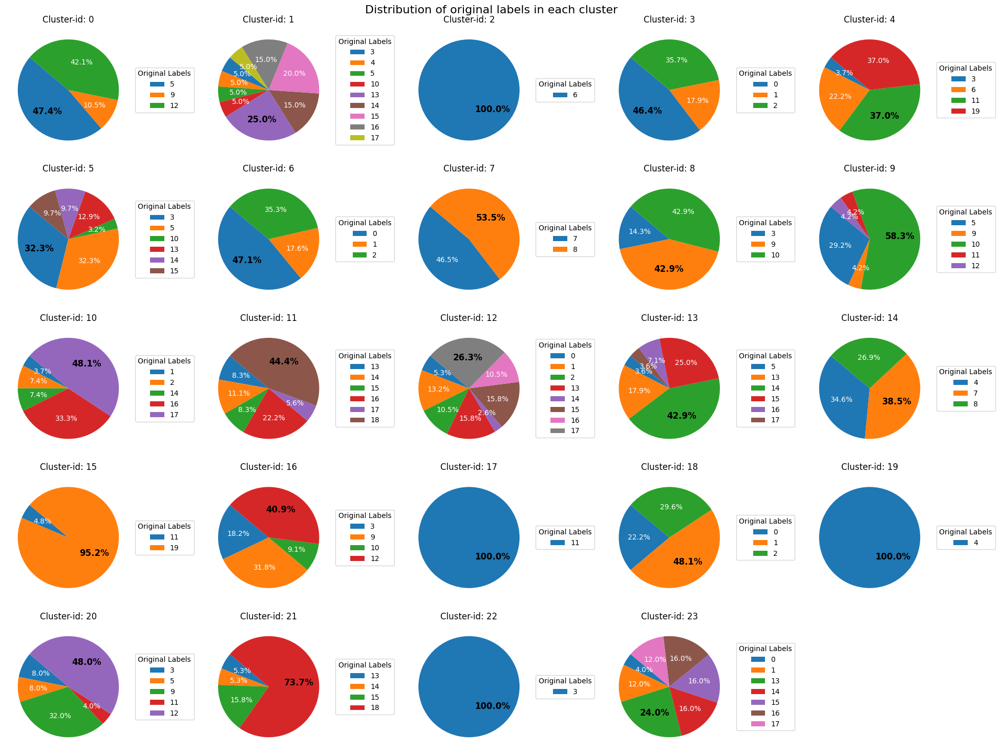

In [40]:
plot_cluster_distribution_with_majority(original_labels, clustered_labels)

In [41]:
def original_labels_distribution(original_labels, cluster_labels):
    original_labels = np.array(original_labels)
    cluster_labels = np.array(cluster_labels)
    
    label_distribution = {}
    
    for original_label in np.unique(original_labels):
        indices = np.where(original_labels == original_label)[0]
        
        clusters = cluster_labels[indices]
        
        cluster_distribution = Counter(clusters)
        
        most_common_cluster, most_common_count = cluster_distribution.most_common(1)[0]
        
        label_distribution[original_label] = {
            'cluster_distribution': cluster_distribution,
            'most_common_cluster': most_common_cluster,
            'most_common_count': most_common_count
        }
        
        print(f'Original label: {original_label}')
        print(f'Cluster distribution: {cluster_distribution}')
        print(f'Most common cluster: {most_common_cluster} ({most_common_count}/{len(indices)} img)')
        print("*******************************************")

In [42]:
original_labels_distribution(original_labels, clustered_labels)

Original label: 0
Cluster distribution: Counter({3: 13, 6: 8, 18: 6, 12: 2, 23: 1})
Most common cluster: 3 (13/30 img)
*******************************************
Original label: 1
Cluster distribution: Counter({18: 13, 3: 5, 12: 5, 6: 3, 23: 3, 10: 1})
Most common cluster: 18 (13/30 img)
*******************************************
Original label: 2
Cluster distribution: Counter({3: 10, 18: 8, 6: 6, 12: 4, 10: 2})
Most common cluster: 3 (10/30 img)
*******************************************
Original label: 3
Cluster distribution: Counter({5: 10, 22: 8, 8: 4, 16: 4, 20: 2, 4: 1, 1: 1})
Most common cluster: 5 (10/30 img)
*******************************************
Original label: 4
Cluster distribution: Counter({19: 20, 14: 9, 1: 1})
Most common cluster: 19 (20/30 img)
*******************************************
Original label: 5
Cluster distribution: Counter({5: 10, 0: 9, 9: 7, 20: 2, 13: 1, 1: 1})
Most common cluster: 5 (10/30 img)
*******************************************
Original 

In [43]:
umist_cropped_training = pd.read_csv("data/umist_cropped.csv")

umist_cropped_training['cluster_id'] = kmeans_labels_umap

umist_cropped_training.to_csv("data/umist_cropped_with_cluster_id_training.csv", index=False)

In [44]:
umist_cropped_val = pd.read_csv("data/validation_data/umist_val.csv")
umist_cropped_test = pd.read_csv("data/test_data/umist_test.csv")

X_val = umist_cropped_val.to_numpy()
X_test = umist_cropped_test.to_numpy()

In [45]:
X_val_scaled = scaler(X_val)
X_val_pca = pca.transform(X_val_scaled)
X_val_umap = best_umap.transform(X_val_pca)

In [46]:
X_test_scaled = scaler(X_test)
X_test_pca = pca.transform(X_test_scaled)
X_test_umap = best_umap.transform(X_test_pca)

In [47]:
cluster_labels_val = kmeans_umap.predict(X_val_umap)

In [48]:
cluster_labels_test = kmeans_umap.predict(X_test_umap)

In [49]:
umist_cropped_val['cluster_id'] = cluster_labels_val
umist_cropped_test['cluster_id'] = cluster_labels_test

In [50]:
umist_cropped_val.to_csv("data/validation_data/umist_cropped_with_cluster_id_val.csv", index=False)
umist_cropped_test.to_csv("data/test_data/umist_cropped_with_cluster_id_test.csv", index=False)